In [4]:
#Needed packages
import pandas as pd
import numpy as np
import openpyxl as op
import matplotlib.pyplot as plt
import scipy.optimize
from yahooquery import Ticker
import datetime
import os



In [5]:
#IMPORTING TABLES WITH THE PARAMETERS WE NEED
#Lets load the workbook 

#finding the absolute path 
abs_path =os.getcwd()
inputs_path = os.path.join(abs_path,'Input_Sheet.xlsx')


wb = op.load_workbook(inputs_path, data_only=True)
# Connecting to the specified worksheet
ws = wb['Home']
# Initliasing an empty list where the excel tables will be imported
# into
var_tables = []

for table in ws._tables: #looping through tables  --  table.ref give the ranges -- table.name give the name
    sht_range = ws[table.ref] #getting the respective ranges and passing in the worksheet
    data_rows = []
    i = 0
    for row in sht_range: #looping row then by column
        j = 0
        i += 1
        data_cols= [] # reset for everyrow 
        for cell in row: #cells in the rows -- columnwise data
            j += 1
            data_cols.append(cell.value)
            if (j == len (row)) & (i == 1): #'header to add table name'
                data_cols.append('Table Name')
            elif j == len(row): #last column
                data_cols.append(table.name)
        data_rows.append(data_cols)
    var_tables.append(data_rows)
wb.close() 


for tb in var_tables:
    df = pd.DataFrame(tb[1:], columns=tb[0])
    table_name = df.iloc[0,-1]
    if table_name == 'Parameters':
        Parameters = df.drop(['Table Name'], axis =1)
        Parameters = Parameters.set_index('Parameters')
    elif table_name == 'Shares_Structure':
        Shares_Structure = df.drop(['Table Name'], axis =1)


In [28]:
#Now lets build a dictionaty with the shares being the keys
'''Dictionary strutucre below:

Dict_shares = {
    ShreName: {
        'Value b/f': 'Double',
        'Weights':'Double'
    }
    Parameters:{
        Benchmark: 'String'
        Starting Period	: 'Date'
        Interval	:'String'}
}
'''

"Dictionary strutucre below:\n\nDict_shares = {\n    ShreName: {\n        'Value b/f': 'Double',\n        'Weights':'Double'\n    }\n    Parameters:{\n        Benchmark: 'String'\n        Starting Period\t: 'Date'\n        Interval\t:'String'}\n}\n"

In [6]:

Dict_shares = {}
Dict_Parameters = {}
temp_dict = {}
#populating dictionary from parameters table
for eachkey in Parameters.index:
    Dict_Parameters[eachkey] = Parameters['Values'][eachkey]
#Dict_Parameters

#Populating dictionary from Shares_Structure table where rows are keys nested with row info where column will be key
# share : {column1 : value, Column2:value ,..., columnN:Value}
for i,row in Shares_Structure.iterrows():
    temp_dict = {}
    for icol in Shares_Structure.columns[1:]:
        temp_dict[icol] = row[icol]

    Dict_shares[row['Share']] = temp_dict

Dict_shares['Parameters'] = Dict_Parameters
Dict_shares
# Dict_shares['BIDI11.SA']['Value b/f']

{'PETR4.SA': {'Cost': 15000, 'Weights': 0.15625},
 'BIDI11.SA': {'Cost': 25000, 'Weights': 0.2604166666666667},
 'ABEV3.SA': {'Cost': 17000, 'Weights': 0.17708333333333334},
 'AZUL4.SA': {'Cost': 5000, 'Weights': 0.052083333333333336},
 'BIDI4.SA': {'Cost': 15000, 'Weights': 0.15625},
 'GOLL4.SA': {'Cost': 7000, 'Weights': 0.07291666666666667},
 'JHSF3.SA': {'Cost': 12000, 'Weights': 0.125},
 'Parameters': {'Benchmark': '^BVSP',
  'Starting Period': datetime.datetime(2019, 1, 1, 0, 0),
  'Interval': '1d',
  'Risk Free Rate': 0.03}}

In [7]:
benchmark = Dict_shares['Parameters']['Benchmark']
Risk_Free = Dict_shares['Parameters']['Risk Free Rate']
 # Turning dictionary keys into a string of shares
myshares = " ".join([mykeys for mykeys in Dict_shares.keys() if mykeys != 'Parameters'])

shares = Ticker(myshares + " " + benchmark)

myweights = [Dict_shares[mykeys]['Weights'] for mykeys in  Dict_shares.keys() if mykeys != 'Parameters']

df = Ticker.history(shares, period='ytd', interval=Dict_shares['Parameters']['Interval'], start= Dict_shares['Parameters']['Starting Period'], end=None)

df.reset_index(level=0, inplace=True)
df.reset_index(level=0, inplace=True)

portifolio = df.pivot(index='date', columns='symbol', values='close')

portifolio = portifolio.dropna()
portifolio.head()

symbol,ABEV3.SA,AZUL4.SA,BIDI11.SA,BIDI4.SA,GOLL4.SA,JHSF3.SA,PETR4.SA,^BVSP
date,,,,,,,,
2019-07-19,18.090000,49.700001,42.689999,13.759405,38.500000,3.51,27.440001,103452.0
2019-07-22,17.990000,49.900002,43.200001,13.749412,38.900002,3.44,27.490000,103949.0
2019-07-23,18.030001,49.029999,42.599998,14.069166,38.619999,3.75,27.520000,103704.0
2019-07-24,17.959999,49.450001,42.830002,13.699451,38.950001,3.70,27.350000,104120.0
2019-07-25,19.490000,50.889999,42.500000,13.829351,38.250000,3.70,26.889999,102655.0


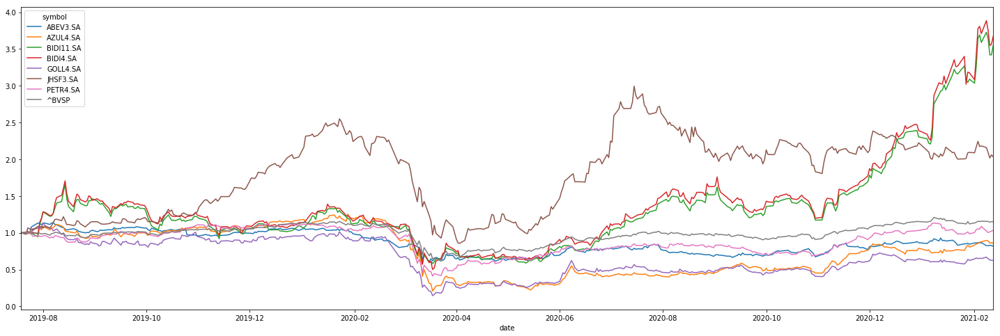

In [8]:
accum_portifolio = portifolio/portifolio.iloc[0,:]
accum_portifolio.plot(figsize=(25,8))

In [58]:
#Let's quickly find out our optimal portifolio but don't worry we will investigate it deeply further down 

#For now let's bound our position from 0 to 1 so we can't be short in a share

n_shares = portifolio.shape[1] -1 #removing benchmark
log_returns = np.log(portifolio/portifolio.shift(1)).dropna()
varcovar = log_returns.iloc[:,:-1].cov()*252

def get_ret_vol_sharpe(weights): #weights as list
    weights = np.array(weights)
    ret = (log_returns.iloc[:,:-1].mean()*252).dot(weights.T)
    vol = np.sqrt(np.dot(weights, np.dot(varcovar,weights.T)))
    Rf = 0 #Risk Free Returns
    sharpe = (ret-Rf)/vol
    return np.array([ret,vol,sharpe])

def negative_sharpe(weights):
    return abs(get_ret_vol_sharpe(weights)[2])*-1

def check_sum_weights(weights):
    #returns 0 if sum is = 1 
    return np.sum(weights) - 1
#writing the parameters for the minimization of the negative sharp <=> max of positive one

bounds = []
for bound in range(n_shares):
    bounds.append((0,1))
bounds = tuple(bounds)

#bounds = tuple([[(-1,1)]*n_shares])#weights varies from 0 to 1 -- this is a tuple
#bounds2 = tuple([[(0,1)]*n_shares])
initial_guess = [[1/n_shares]*n_shares] #spread it equaly first guess
cons_first = ({'type':'eq', 'fun':check_sum_weights}) #dictionary of constrains
opt_results_weights_first = scipy.optimize.minimize(negative_sharpe, initial_guess, method='SLSQP' , bounds=bounds, constraints=cons_first) # try taking bound out 
print(opt_results_weights_first)
OptimalWeight = opt_results_weights_first.x

     fun: -1.1820298981233324
     jac: array([ 5.39793178e-01,  1.12143402e+00, -1.00508332e-04,  6.02900982e-05,
        1.45108926e+00,  3.24890018e-04,  5.78480482e-01])
 message: 'Optimization terminated successfully.'
    nfev: 72
     nit: 8
    njev: 8
  status: 0
 success: True
       x: array([0.00000000e+00, 1.04807624e-15, 7.51004083e-01, 2.05170789e-02,
       0.00000000e+00, 2.28478838e-01, 0.00000000e+00])


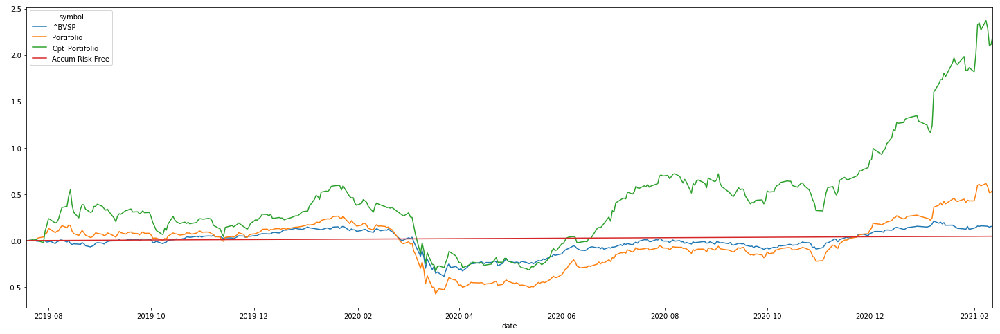

In [59]:
Risk_Free_Daily = ((1 + Risk_Free)**(1/252)-1)
accum_portifolio = portifolio/portifolio.iloc[0,:] - 1
accum_portifolio['Portifolio'] = ''
accum_portifolio['Opt_Portifolio'] = ''
accum_portifolio['Accum Risk Free'] = ''
accum_portifolio['Portifolio']  = accum_portifolio.iloc[:,:-4].dot(myweights)
accum_portifolio['Opt_Portifolio']  = accum_portifolio.iloc[:,:-4].dot(OptimalWeight)
accum_portifolio['Accum Risk Free'] = [((1+Risk_Free_Daily)**(t+1))-1 for t,a in enumerate(accum_portifolio['Portifolio']) ] #(t+1) just because of the indexing zero
accum_portifolio.iloc[:,-4:].plot(figsize=(25,8))

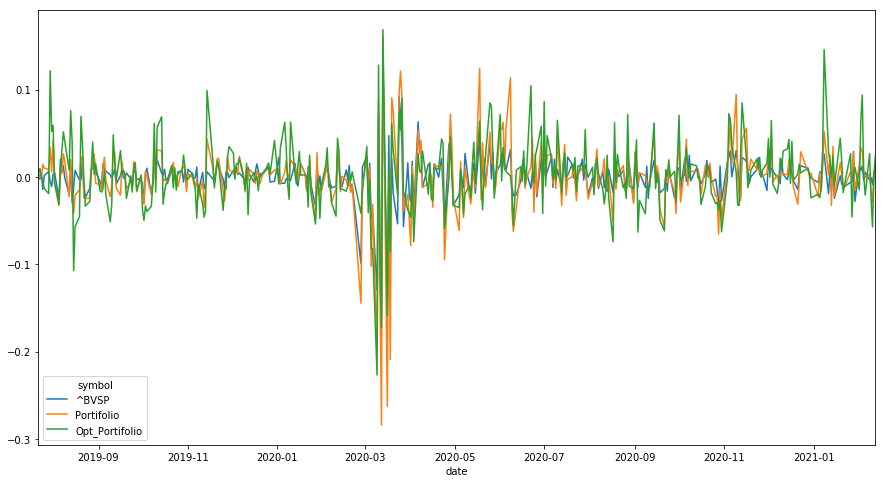

In [60]:
Log_return = np.log(portifolio/portifolio.shift(1))

Log_return['Portifolio'] = ''
Log_return['Opt_Portifolio'] = ''
#Log_return['Accum Risk Free'] = ''
Log_return['Opt_Portifolio'] = Log_return.iloc[:,:-3].dot(OptimalWeight)
#Log_return['Accum Risk Free'] = accum_portifolio['Accum Risk Free'].pct_change() #np.log(accum_portifolio['Accum Risk Free']/accum_portifolio['Accum Risk Free'].shift(1))
Log_return['Portifolio'] = Log_return.iloc[:,:-3].dot(myweights)
Log_return = Log_return.dropna()
Log_return.iloc[:,-3:].plot(figsize=(15,8))

Text(0,0.5,'Freq')

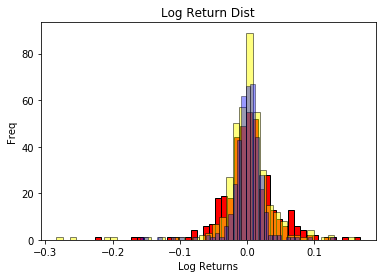

In [61]:

import seaborn as sns
bandw = Log_return['Portifolio'].max() - Log_return['Portifolio'].min()

plt.hist(Log_return['Opt_Portifolio'], color = 'red', edgecolor = 'black', bins = int(bandw/0.01))
plt.hist(Log_return['Portifolio'], color = 'yellow', alpha = 0.5, edgecolor = 'black', bins = int(bandw/0.01))
sns.distplot(Log_return[benchmark], hist=True, kde=False, bins=int(bandw/0.01), color = 'blue', hist_kws={'edgecolor':'black'})
#Add labels
plt.title('Log Return Dist')
plt.xlabel('Log Returns')
plt.ylabel('Freq')

In [36]:
# calculate mean
#m = sum(results) / len(results)
# calculate variance using a list comprehension
#var_res = sum((xi - m) ** 2 for xi in results) / len(results)
#Log_return.index.name

In [62]:
#Comparing weekly stats
#Daily stats grouped weekly -- to make more sense I will multiply by sqrt(5) 
GroupStats = Log_return
GroupStats['Date'] = Log_return.index
GroupStats['Date'] = pd.to_datetime(GroupStats['Date'])
GroupStats = GroupStats.groupby(pd.Grouper(key= 'Date', freq='W-FRI'))

WeeklyStats = []
WeeklyStats = pd.DataFrame(WeeklyStats)

PortstdWeek = GroupStats['Portifolio'].std()*np.sqrt(5)
PortER = GroupStats['Portifolio'].mean()*5 - ((1 + Risk_Free)**(5/252)-1)

WeeklyStats['Sharp Portifolio'] = PortER/PortstdWeek

BMstdWeek = GroupStats[benchmark].std()*np.sqrt(5)
BMER = GroupStats[benchmark].mean()*5 - ((1 + Risk_Free)**(5/252)-1)

WeeklyStats['Sharp '+benchmark] =  BMER /BMstdWeek

Sdt_optPortifolio = GroupStats['Opt_Portifolio'].std()*np.sqrt(5)
optPortER = GroupStats['Opt_Portifolio'].mean()*5 - ((1 + Risk_Free)**(5/252)-1)

WeeklyStats['Sharp Optimal Portifolio'] = optPortER/Sdt_optPortifolio 

WeeklyStats.loc[WeeklyStats['Sharp Optimal Portifolio'] == WeeklyStats['Sharp Optimal Portifolio'].min()]


,Sharp Portifolio,Sharp ^BVSP,Sharp Optimal Portifolio
Date,,,
2020-10-30,-3.471827,-1.552004,-5.669573


In [63]:
testingdata = Log_return
mydate =pd.to_datetime(WeeklyStats.loc[WeeklyStats['Sharp Optimal Portifolio'] == WeeklyStats['Sharp Optimal Portifolio'].min()].index[0])
testingdata['Date'] = Log_return.index
testingdata['Date'] = pd.to_datetime(testingdata['Date'])
testingdata = testingdata.loc[testingdata['Date'] <= mydate] #.isocalendar()[1]]
testingdata.to_excel("output.xlsx")  

In [39]:
optPortER.min()  #loc[optPortER.iloc[:,0]==optPortER.min()]

-0.2133248843411045

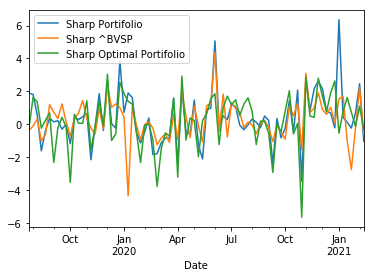

In [64]:
WeeklyStats.plot() ## you can cut the outliars to smooth out the decision as its unlikely to happen huge spikes

In [65]:
#BTW I know we are repeting all the functions above but I think now it's the time to explain them and I had to define them previously to get the weights so now let's do it again more detailed
#Yes I could have called a different python file but I want everything in one file
#let's find out what set f weights give us the max sharp ratio
#for that we need to start building a couple of functions for the optimization

#first function will give us an array with [Return, Volatility, Sharp Ratio] for given weights
#WE WILL BE ANNUALISING THE DATA BELOW
portf_log_return = Log_return.iloc[:,:n_shares]
portf_mean = portf_log_return.mean()*252
portf_cov = portf_log_return.cov()*252
def get_ret_vol_sharpe(weights):
    #to make sure lets turn weights into an array 
    weights = np.array(weights)
    preturn = weights.dot(portf_mean.T)
    vol = np.sqrt(weights.dot(portf_cov.dot(weights.T)))
    sharp_ratio = ( preturn -Risk_Free )/vol
    return np.array([preturn,vol,sharp_ratio])
#we will be using minimisation method so let's invert the sharp above by mult -1, given the weights we pass in the other funtion and *-1
def negative_sharpe(weights):
    # the number 2 is the sharpe ratio index from the get_ret_vol_sharp
    return abs(get_ret_vol_sharpe(weights)[2])*-1
#below is one of our constrains sum(weights) = 1
#return 0 if the sum is one
def check_sum_weights(weights):
    return np.sum(weights) - 1

In [66]:
#dynamically buiding the bounds 
bound_0_1 = []
for b in range(n_shares):
    bound_0_1.append((0,1))
bound_0_1 = tuple(bound_0_1)

const = ({'type':'eq', 'fun':check_sum_weights}) # passing our constraints
#Lets give a place to start as a guessin making the optimisation proccess more efficient
init_guess = [[1/n_shares]*n_shares]

In [67]:
max_sharpe_weights = scipy.optimize.minimize (negative_sharpe, init_guess, method = 'SLSQP', bounds = bound_0_1, constraints=const )
print(max_sharpe_weights)

     fun: -1.134487851967997
     jac: array([ 0.51840635,  1.06251253, -0.04736428, -0.04726173,  1.38836896,
       -0.04711215,  0.54350626])
 message: 'Optimization terminated successfully.'
    nfev: 72
     nit: 8
    njev: 8
  status: 0
 success: True
       x: array([0.00000000e+00, 1.07116374e-15, 7.56268090e-01, 3.42636198e-02,
       0.00000000e+00, 2.09468290e-01, 0.00000000e+00])


In [44]:
#Now let's build our efficient frontier by passing the returns and getting the weights that result in the min vol possible for that return 

#The for loop is basically going through every possible value in our previously defined frontier_y and obtaining the minimum result (which is the key ‘fun’) of volatility (our x axis in the chart).

#to find the frontier we need to have a function depending on returnts 
#minVol(r)
#so let's ass a new constraint 
#RW = Rp -- this will turn the results to depend on 
#so our both constrains are 
# 1W = 1
# RW = Rp
# and as good old lagrange when you derivate in respect to lambda = 0  you get:
# 1W-1 = 0
# RW - Rp = 0 
#so let's write that 
#NOTE: I will be rewritting the constraints just for practicing purpuse 


In [68]:
#First contraint
# def check_sum_weights(weights):
#     return np.sum(weights) - 1
#second constraint
def sum_returns_check(weights, port_return):
    return weights.dot(portf_mean.T) - port_return

return_of_max_sharp = get_ret_vol_sharpe(max_sharpe_weights.x)[0]
frontier_y = np.linspace(0,return_of_max_sharp+0.1,300)

frontier_x = []

for possible_returns in frontier_y:
    double_const = ({'type':'eq', 'fun':check_sum_weights},
            {'type':'eq', 'fun': lambda w: sum_returns_check(w,possible_returns)})  #lambda w: get_ret_vol_sr(w)[0] - possible_return})
    max_sharpe_given_return = scipy.optimize.minimize (lambda w: get_ret_vol_sharpe(w)[1], init_guess, method = 'SLSQP', bounds = bound_0_1, constraints=double_const )
    # print(max_sharpe_g
    # .iven_return['fun'])
    # print(max_sharpe_given_return['fun'] == get_ret_vol_sharpe(max_sharpe_given_return.x)[1])
    # break
    frontier_x.append(max_sharpe_given_return['fun'])        
# frontier_x        

In [70]:
#Let's test if we maximise the sharpe ratio given return it will be the same as minimising volatility (in our case we will minimise the negaitve shape (same thing))
#I am expecting to see same results because as the return will be a constraint you need to minimize the vol to maximise the sharp 
#the problem is for returns below risk free rate the negative sharp will be positive and to minimize it vol tend to inifinity also when return = risk free will tend to inifinity
#good way to fix it and I have done above is use the absolute value of the sharp to later multiply by -1 however you are going to stll get weird results when Return = risk free because the top will be zero
frontier_x2 = []

for possible_returns in frontier_y:
     #})
    double_const = ({'type':'eq', 'fun':check_sum_weights},{'type':'eq', 'fun': lambda w: get_ret_vol_sharpe(w)[0] - possible_returns})

    max_sharpe_given_return2 = scipy.optimize.minimize (negative_sharpe, init_guess, method = 'SLSQP', bounds = bound_0_1, constraints=double_const )
    # print(max_sharpe_given_return['fun'])
    # print(max_sharpe_given_return['fun'] == get_ret_vol_sharpe(max_sharpe_given_return.x)[1])
    # break
    frontier_x2.append(get_ret_vol_sharpe(max_sharpe_given_return2.x)[1])        
# frontier_x        


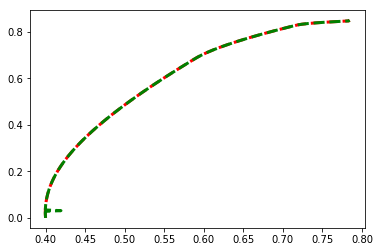

In [71]:
plt.plot(frontier_x,frontier_y, 'r--', linewidth=3)
plt.plot(frontier_x2,frontier_y, 'g--', linewidth=3)

In [72]:
#Ok great now that we know how to build a frontier let's make some cool analysis 
#let's start buy populating a graph with random portifolio allocations
#then we will come back later fitting the best frontier for these shares 

#Start creating a array skelleton which will hold your random weights allocation

np.random.seed(42) #let's use the same seed just for replicability
no_portifolios = 100000 # if it's taking to long to process just make it smaller


all_weights = np.zeros((no_portifolios,n_shares)) #no_portifoliosxN
return_array = np.zeros(no_portifolios) #no_portifoliosx1
vol_array = np.zeros(no_portifolios)  #no_portifoliosx1
sharpe_array = np.zeros(no_portifolios)  #no_portifoliosx1

#Some of the variables are inherent to the shares the weights just make a liniar combination of them, e.g. E(Shares)(1xN) , VarCovar(Shares)(NxN)
#Let's define them before as we don't need to calculate it all the time
#let's also annualize the metrics (that makes it innacurate as it assumes same profile of risk for the whole year on avarage)

E_LReturns = Log_return.iloc[:,:n_shares].mean()*252 #annualised
Cov_LReturns = Log_return.iloc[:,:n_shares].cov()*252 #annualised

x = 0 
for x in range(no_portifolios):
    #"randomly" generating the position
    weights = np.array(np.random.random(n_shares))
    #now making sure they sum up one
    weights = weights/np.sum(weights)
    
    #now populating the skelleton array of weights
    all_weights[x,:] = weights

    #populate array of returns given the weights
    #if you want to do this at once just do it outside the loop 
    # return_array = all_weights[x,:].dot(E_LReturns.T)

    return_array[x] = E_LReturns.dot(weights.T)

    #pop vol array
    #if you want to check the proof of WCovW' it's on my notebook
    #hint E[(WR' - WE(R)')(RW' - E(R)W')] = WE[(R'-E(R)')(R-E(R))]W'=WCovW'
    # if W nx1 then W'CovW
    vol_array[x] = np.sqrt(weights.dot(Cov_LReturns.dot(weights.T)))

    # Sharpe Ratio
    #will do it at once outside the loop
    #if you want to do it here use the below
    #sharpe_array[x] = return_array[x]/vol_array[x]

sharpe_array = (return_array - Risk_Free)/vol_array




Text(0,0.5,'Return')

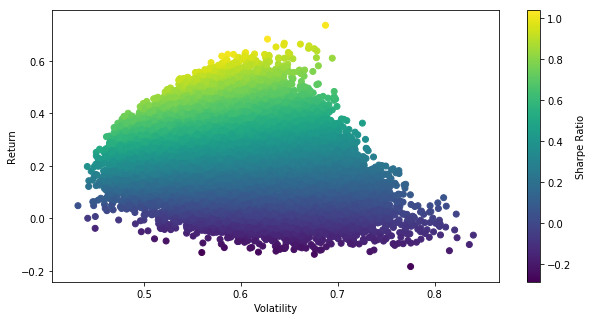

In [73]:
#Let's plot all the random allocations generated above :)
#After we will do some tests in the frontier optmisation
plt.figure(figsize=(10,5))
plt.scatter(vol_array, return_array, c=sharpe_array, cmap='viridis')
plt.colorbar(label='Sharpe Ratio')
plt.xlabel('Volatility')
plt.ylabel('Return')

In [74]:
#Let's solve our problem, out objective funtion is W'CovW and we need to minimise it give the return and the weights need to sum 1
#For W(nx1) , 1(1xn)
#Let's use Lagrange to solve this Min W'CovW s.t. 1W = 1 , E(Rp)W = E(Rt) (Given expected return) so you make sure you will have the weights that gives you that expected return with the minimum volatility
#To start let's build our lagrangian matrix if you wanna see the derivation please check my notebook, please note £ = Lambda
#the L matrix looks like this L = [[2Cov -E(Rp) -1' ], [[ W  ],    [[  0  ],
#                                  [E(Rp)' 0     0  ],  [ £1 ], =   [E(Rt)],
#                                  [1      0     0  ]]  [ £2 ]]     [  1  ]]

#Now let's write it down in a array formula to solve this later
# we already have E(Returns) and Cov so let's turn them into arrays
E_LReturns = pd.DataFrame(E_LReturns)
E_LReturns = np.array(E_LReturns)
Cov_LReturns = np.array(Cov_LReturns)
L_zeros = np.zeros((1,2))
L_ones = np.array([[1]*n_shares])

L_matrix = np.block([
    [Cov_LReturns*2,E_LReturns*(-1),L_ones.T*(-1)],
    [E_LReturns.T,L_zeros],
    [L_ones,L_zeros]
    ])
#Now that we built the lagrangean let's find its inverse to solve the equation :)
L_matrix = np.array(L_matrix)
L_matrix_Inverse = np.linalg.inv(L_matrix)

In [75]:
#let's now build a function which will give you the minimum vol given the return passed in your constraint
#for that we need to make the E(Rt) a variable to be changed in the matrix on the right side of the lagrange solution, so we can pass it in a function and obtain the weight allocation that gives us the lowest volatility

def minVol_given_Ereturn(Ereturn):
    L_zeros_result = np.zeros((n_shares,1))
    L_Result = np.block([
        [L_zeros_result],
        [Ereturn],
        [1]
    ])
    L_Result = np.array(L_Result)
    L_solution = L_matrix_Inverse.dot(L_Result)
    L_weights = L_solution[:-2].T#-2 because we have two lambdas from two constraints and we are focusing on getting the weights
    return get_ret_vol_sharpe(L_weights)[1]

In [76]:
#Let's now plot the what would be our minVol given the returns we randomly generated before
frontier_x_lagrange = []
for Preturns in return_array:
    frontier_x_lagrange.append(minVol_given_Ereturn(Preturns))


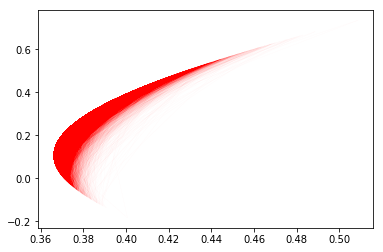

In [77]:
#now let's plot to see what we have got !
plt.plot(frontier_x_lagrange,return_array, 'r--', linewidth=0.01)

In [94]:
#As we can notice on the graph above not setting the boudaries for wegihts you can 
#Now let's use scipy.optimize to plot the same frontier in 3 different ways 
# Boundaries (0,1), boundaries(-1,1) and no Boundaries 
#For that let's build in the constrains being the expected total return one of them
#First the boundaries:

#our returns will be in the y axis in a liniear space 0 to 0.7

expected_returns_y_axis = np.linspace(0,0.9,400)

bound_0_1 = bound_0_1

bounds_1_1 = []
for bound2 in range(n_shares):
    bounds_1_1.append((-1,1))
bounds_1_1 = tuple(bounds_1_1)

boundaries_list = [bound_0_1,bounds_1_1]

#Great we have our boundaries let's now write our constraints
#we already have the one that makes sure W'1 - 1 = 0 => check_sum_weights

def sum_returns_equal_ER(weights,givenreturn):
    return get_ret_vol_sharpe(weights)[0] - givenreturn


frontier_x_bound_0_1 = []



In [95]:

frontiers_x = []
for mybounds in boundaries_list:

    temp_frontier = []
    for expected_returns in expected_returns_y_axis:
        constraints_again = ({'type':'eq', 'fun':check_sum_weights},
                    {'type':'eq', 'fun': lambda w: sum_returns_equal_ER(w, expected_returns)}                   )

        min_vol = scipy.optimize.minimize( lambda w: get_ret_vol_sharpe(w)[1], init_guess,method='SLSQP', bounds = mybounds, constraints=constraints_again)

        temp_frontier.append(min_vol['fun'])
    frontiers_x.append(temp_frontier)




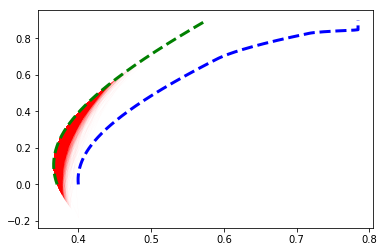

In [96]:
#Note in other tests I tested that no bounds is equal to (-1,1) bounds and it's true

plt.plot(frontier_x_lagrange,return_array, 'r--', linewidth = 0.01)
plt.plot(frontiers_x[0],expected_returns_y_axis, 'b--', linewidth = 3)
plt.plot(frontiers_x[1],expected_returns_y_axis, 'g--', linewidth = 3)

In [97]:
#Let's now include our CML to the model 
max_sharp_ratio = scipy.optimize.minimize(negative_sharpe, init_guess, method='SLSQP',bounds=boundaries_list[0], constraints=double_const[0])
max_sharp_ratio_Ret_Vol_Sp = get_ret_vol_sharpe(max_sharp_ratio.x)



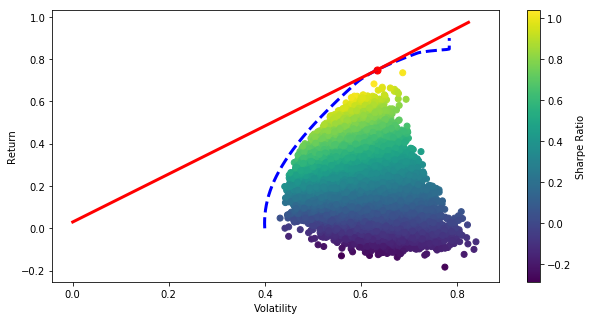

In [100]:
plt.figure(figsize=(10,5))
plt.scatter(vol_array, return_array, c=sharpe_array, cmap='viridis')
plt.colorbar(label='Sharpe Ratio')
plt.xlabel('Volatility')
plt.ylabel('Return')
plt.plot(frontiers_x[0],expected_returns_y_axis, 'b--', linewidth = 3)
plt.scatter(max_sharp_ratio_Ret_Vol_Sp[1], max_sharp_ratio_Ret_Vol_Sp[0],c='red', s=50) # red
plt.plot([0,max_sharp_ratio_Ret_Vol_Sp[1],max_sharp_ratio_Ret_Vol_Sp[1]*1.3],[Risk_Free,max_sharp_ratio_Ret_Vol_Sp[0],max_sharp_ratio_Ret_Vol_Sp[0]*1.3], 'r-', linewidth = 3)